# Terörizmin Etkilerine Genel Bir Bakış


## Contents

1. Introduction
2. Goal of The Project
3. General View of The Data
4. Data Cleaning
5. Data Exploration
6. Conclusion

### 1. Introduction

EXPLORATORY DATA ANALYSIS (EDA) projemizde National Consortium for the Study of Terrorism and Responses to Terrorism (START), headquartered at the University of Maryland tarafından hazırlanan, 1970-2017 yıllarında dünya genelinde meydana gelen 180.000'in üzerinde terör eylemini içeren, Global Terrorism Database ini kullanmaktayız. 

### 2. Goal of The Project

Bu projede; Terörizmin küresel ve bölgesel ölçekte etkilerinin incelenmesi, terörist gruplar ve eylemleri, hangi eylem tiplerinin ne tür ölümcül sonuçlar doğurduğunun incelenmesi amaçlanmştır.

### 3. General View of The Data


### Type of Variables

#### Categorical Variables

- Country
- Region
- City
- Attack_Type
- Target_Type
- Perpetrator_Group
- Target_type
- Weapon_type
- Attack_Code
- Weapon_Code
- Target_Code

#### Continuous Variables

- Year
- Month
- Day
- Latitude
- Longitude
- Killed
- Wounded


<b>Year:</b> The year in which the incident occurred. <b>Month:</b> The number of the month in which the incident occurred. <b>Day:</b> The numeric day of the month on which the incident occurred. <b>Country:</b> The country or location where the incident occurred. <b>Region:</b> The region in which the incident occurred. The regions are divided into the 12 categories. <b>City:</b> The name of the city, village, or town in which the incident occurred. <b>Latitude:</b> The latitude (based on WGS1984 standards) of the city in which the event occurred. <b>Longitude:</b> The longitude (based on WGS1984 standards) of the city in which the event occurred. Attack_Code:...... <b>Attack_Type:</b> The general method of attack and often reflects the broad class of tactics used. It consists of nine categories. <b>Killed:</b> The number of total confirmed fatalities for the incident <b>Wounded:</b> The number of confirmed non-fatal injuries to both perpetrators and victims. <b>Target:</b> The specific person, building, installation, etc., that was targeted and/or victimized and is a part of the entity. <b>Perpetrator_Group:</b> The name of the group that carried out the attack.Target_Code:..... <b>Target_Type:</b> The general type of target/victim. This variable consists of the following 22 categories. Weapon_Code:....... <b>Weapon_type:</b> The type of weapon. Up to four weapon types are recorded for each incident. It consists 13 categories.

## 4. Data Cleaning

#### *Importing necessary packages for our EDA project

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import collections
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Upload the global terrorism data set

gtd = pd.read_csv("../globalterrorismdb_0718dist.csv", encoding = "ISO-8859-1")
gtd.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [3]:
gtd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


In [4]:
for i in gtd.columns:
    print(i)

eventid
iyear
imonth
iday
approxdate
extended
resolution
country
country_txt
region
region_txt
provstate
city
latitude
longitude
specificity
vicinity
location
summary
crit1
crit2
crit3
doubtterr
alternative
alternative_txt
multiple
success
suicide
attacktype1
attacktype1_txt
attacktype2
attacktype2_txt
attacktype3
attacktype3_txt
targtype1
targtype1_txt
targsubtype1
targsubtype1_txt
corp1
target1
natlty1
natlty1_txt
targtype2
targtype2_txt
targsubtype2
targsubtype2_txt
corp2
target2
natlty2
natlty2_txt
targtype3
targtype3_txt
targsubtype3
targsubtype3_txt
corp3
target3
natlty3
natlty3_txt
gname
gsubname
gname2
gsubname2
gname3
gsubname3
motive
guncertain1
guncertain2
guncertain3
individual
nperps
nperpcap
claimed
claimmode
claimmode_txt
claim2
claimmode2
claimmode2_txt
claim3
claimmode3
claimmode3_txt
compclaim
weaptype1
weaptype1_txt
weapsubtype1
weapsubtype1_txt
weaptype2
weaptype2_txt
weapsubtype2
weapsubtype2_txt
weaptype3
weaptype3_txt
weapsubtype3
weapsubtype3_txt
weaptype4
weapt

In [5]:
for i in range (0, 136, 10):
    display (gtd.iloc[0:10, i:i+10])

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4
5,197001010002,1970,1,1,NaN,0,NaN,217,United States,1
6,197001020001,1970,1,2,NaN,0,NaN,218,Uruguay,3
7,197001020002,1970,1,2,NaN,0,NaN,217,United States,1
8,197001020003,1970,1,2,NaN,0,NaN,217,United States,1
9,197001030001,1970,1,3,NaN,0,NaN,217,United States,1


,region_txt,provstate,city,latitude,longitude,specificity,vicinity,location,summary,crit1
0,Central America & Caribbean,NaN,Santo Domingo,18.456792,-69.951164,1.0,0,NaN,NaN,1
1,North America,Federal,Mexico city,19.371887,-99.086624,1.0,0,NaN,NaN,1
2,Southeast Asia,Tarlac,Unknown,15.478598,120.599741,4.0,0,NaN,NaN,1
3,Western Europe,Attica,Athens,37.997490,23.762728,1.0,0,NaN,NaN,1
4,East Asia,Fukouka,Fukouka,33.580412,130.396361,1.0,0,NaN,NaN,1
5,North America,Illinois,Cairo,37.005105,-89.176269,1.0,0,NaN,1/1/1970: Unknown African American assailants ...,1
6,South America,Montevideo,Montevideo,-34.891151,-56.187214,1.0,0,NaN,NaN,1
7,North America,California,Oakland,37.791927,-122.225906,1.0,0,Edes Substation,1/2/1970: Unknown perpetrators detonated explo...,1
8,North America,Wisconsin,Madison,43.076592,-89.412488,1.0,0,NaN,"1/2/1970: Karl Armstrong, a member of the New ...",1
9,North America,Wisconsin,Madison,43.072950,-89.386694,1.0,0,NaN,"1/3/1970: Karl Armstrong, a member of the New ...",1


,crit2,crit3,doubtterr,alternative,alternative_txt,multiple,success,suicide,attacktype1,attacktype1_txt
0,1,1,0.0,NaN,NaN,0.0,1,0,1,Assassination
1,1,1,0.0,NaN,NaN,0.0,1,0,6,Hostage Taking (Kidnapping)
2,1,1,0.0,NaN,NaN,0.0,1,0,1,Assassination
3,1,1,0.0,NaN,NaN,0.0,1,0,3,Bombing/Explosion
4,1,1,-9.0,NaN,NaN,0.0,1,0,7,Facility/Infrastructure Attack
5,1,1,0.0,NaN,NaN,0.0,1,0,2,Armed Assault
6,1,1,0.0,NaN,NaN,0.0,0,0,1,Assassination
7,1,1,1.0,2.0,Other Crime Type,0.0,1,0,3,Bombing/Explosion
8,1,1,0.0,NaN,NaN,0.0,1,0,7,Facility/Infrastructure Attack
9,1,1,0.0,NaN,NaN,0.0,1,0,7,Facility/Infrastructure Attack


,attacktype2,attacktype2_txt,attacktype3,attacktype3_txt,targtype1,targtype1_txt,targsubtype1,targsubtype1_txt,corp1,target1
0,NaN,NaN,NaN,NaN,14,Private Citizens & Property,68.0,Named Civilian,NaN,Julio Guzman
1,NaN,NaN,NaN,NaN,7,Government (Diplomatic),45.0,"Diplomatic Personnel (outside of embassy, cons...",Belgian Ambassador Daughter,"Nadine Chaval, daughter"
2,NaN,NaN,NaN,NaN,10,Journalists & Media,54.0,Radio Journalist/Staff/Facility,Voice of America,Employee
3,NaN,NaN,NaN,NaN,7,Government (Diplomatic),46.0,Embassy/Consulate,NaN,U.S. Embassy
4,NaN,NaN,NaN,NaN,7,Government (Diplomatic),46.0,Embassy/Consulate,NaN,U.S. Consulate
5,NaN,NaN,NaN,NaN,3,Police,22.0,"Police Building (headquarters, station, school)",Cairo Police Department,Cairo Police Headquarters
6,NaN,NaN,NaN,NaN,3,Police,25.0,Police Security Forces/Officers,Uruguayan Police,Juan Maria de Lucah/Chief of Directorate of in...
7,NaN,NaN,NaN,NaN,21,Utilities,107.0,Electricity,Pacific Gas & Electric Company,Edes Substation
8,NaN,NaN,NaN,NaN,4,Military,28.0,Military Recruiting Station/Academy,R.O.T.C.,"R.O.T.C. offices at University of Wisconsin, M..."
9,NaN,NaN,NaN,NaN,2,Government (General),21.0,Government Building/Facility/Office,Selective Service,Selective Service Headquarters in Madison Wisc...


,natlty1,natlty1_txt,targtype2,targtype2_txt,targsubtype2,targsubtype2_txt,corp2,target2,natlty2,natlty2_txt
0,58.0,Dominican Republic,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,21.0,Belgium,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,217.0,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,217.0,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,217.0,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,217.0,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,218.0,Uruguay,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,217.0,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,217.0,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,217.0,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


,targtype3,targtype3_txt,targsubtype3,targsubtype3_txt,corp3,target3,natlty3,natlty3_txt,gname,gsubname
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,MANO-D,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23rd of September Communist League,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Unknown,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Unknown,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Unknown,NaN
5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Black Nationalists,NaN
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Tupamaros (Uruguay),NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Unknown,NaN
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New Year's Gang,NaN
9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New Year's Gang,NaN


,gname2,gsubname2,gname3,gsubname3,motive,guncertain1,guncertain2,guncertain3,individual,nperps
0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,NaN
1,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,7.0
2,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,NaN
3,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,NaN
4,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,NaN
5,NaN,NaN,NaN,NaN,To protest the Cairo Illinois Police Deparment,0.0,NaN,NaN,0,-99.0
6,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,3.0
7,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,-99.0
8,NaN,NaN,NaN,NaN,To protest the War in Vietnam and the draft,0.0,NaN,NaN,0,1.0
9,NaN,NaN,NaN,NaN,To protest the War in Vietnam and the draft,0.0,NaN,NaN,0,1.0


,nperpcap,claimed,claimmode,claimmode_txt,claim2,claimmode2,claimmode2_txt,claim3,claimmode3,claimmode3_txt
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,-99.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,-99.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,1.0,1.0,1.0,Letter,NaN,NaN,NaN,NaN,NaN,NaN
9,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


,compclaim,weaptype1,weaptype1_txt,weapsubtype1,weapsubtype1_txt,weaptype2,weaptype2_txt,weapsubtype2,weapsubtype2_txt,weaptype3
0,NaN,13,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,13,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,13,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,6,Explosives,16.0,Unknown Explosive Type,NaN,NaN,NaN,NaN,NaN
4,NaN,8,Incendiary,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,5,Firearms,5.0,Unknown Gun Type,NaN,NaN,NaN,NaN,NaN
6,NaN,5,Firearms,2.0,Automatic or Semi-Automatic Rifle,NaN,NaN,NaN,NaN,NaN
7,NaN,6,Explosives,16.0,Unknown Explosive Type,NaN,NaN,NaN,NaN,NaN
8,NaN,8,Incendiary,19.0,Molotov Cocktail/Petrol Bomb,NaN,NaN,NaN,NaN,NaN
9,NaN,8,Incendiary,20.0,Gasoline or Alcohol,NaN,NaN,NaN,NaN,NaN


,weaptype3_txt,weapsubtype3,weapsubtype3_txt,weaptype4,weaptype4_txt,weapsubtype4,weapsubtype4_txt,weapdetail,nkill,nkillus
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Explosive,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Incendiary,NaN,NaN
5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Several gunshots were fired.,0.0,0.0
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Automatic firearm,0.0,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Firebomb consisting of gasoline,0.0,0.0
9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Poured gasoline on the floor and lit it with a...,0.0,0.0


,nkillter,nwound,nwoundus,nwoundte,property,propextent,propextent_txt,propvalue,propcomment,ishostkid
0,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,0.0
1,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,1.0
2,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,0.0
3,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,0.0
4,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,0.0
5,0.0,0.0,0.0,0.0,1,3.0,Minor (likely < $1 million),NaN,NaN,0.0
6,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,0.0
7,0.0,0.0,0.0,0.0,1,3.0,Minor (likely < $1 million),22500.0,Three transformers were damaged.,0.0
8,0.0,0.0,0.0,0.0,1,3.0,Minor (likely < $1 million),60000.0,"Basketball courts, weight room, swimming pool,...",0.0
9,0.0,0.0,0.0,0.0,1,3.0,Minor (likely < $1 million),NaN,Slight damage,0.0


,nhostkid,nhostkidus,nhours,ndays,divert,kidhijcountry,ransom,ransomamt,ransomamtus,ransompaid
0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
1,1.0,0.0,NaN,NaN,NaN,Mexico,1.0,800000.0,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN


,ransompaidus,ransomnote,hostkidoutcome,hostkidoutcome_txt,nreleased,addnotes,scite1,scite2,scite3,dbsource
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS
5,NaN,NaN,NaN,NaN,NaN,"The Cairo Chief of Police, William Petersen, r...","""Police Chief Quits,"" Washington Post, January...","""Cairo Police Chief Quits; Decries Local 'Mili...","Christopher Hewitt, ""Political Violence and Te...",Hewitt Project
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS
7,NaN,NaN,NaN,NaN,NaN,"Damages were estimated to be between $20,000-$...",Committee on Government Operations United Stat...,"Christopher Hewitt, ""Political Violence and Te...",NaN,Hewitt Project
8,NaN,NaN,NaN,NaN,NaN,The New Years Gang issue a communiqué to a loc...,"Tom Bates, ""Rads: The 1970 Bombing of the Army...","David Newman, Sandra Sutherland, and Jon Stewa...","The Wisconsin Cartographers' Guild, ""Wisconsin...",Hewitt Project
9,NaN,NaN,NaN,NaN,NaN,"Karl Armstrong's girlfriend, Lynn Schultz, dro...",Committee on Government Operations United Stat...,"Tom Bates, ""Rads: The 1970 Bombing of the Army...","David Newman, Sandra Sutherland, and Jon Stewa...",Hewitt Project


,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,0,0,0,0,NaN
1,0,1,1,1,NaN
2,-9,-9,1,1,NaN
3,-9,-9,1,1,NaN
4,-9,-9,1,1,NaN
5,-9,-9,0,-9,NaN
6,0,0,0,0,NaN
7,-9,-9,0,-9,NaN
8,0,0,0,0,NaN
9,0,0,0,0,NaN


* As can be seen in the figure above there are lots of 'NaN' value in the data set. So we must to clean some columns. And rename that new columns.

In [6]:
w_df=gtd[['iyear','imonth','iday','country', 'country_txt','region_txt','city',
          'latitude','longitude','attacktype1','attacktype1_txt','targtype1','targtype1_txt','natlty1_txt',
               'gname','weaptype1','weaptype1_txt','nkill','nwound']]
w_df.rename(columns={'iyear':'Year','imonth':'Month','iday':'Day','country':'Country_Code',
                     'country_txt':'Country_Name','region_txt':'Region','city':'City',
                     'latitude':'Latitude','longitude':'Longitude', 'attacktype1':'Attack_Code',
                     'attacktype1_txt':'Attack_Type','targtype1':'Target_Code','targtype1_txt':'Target_Type',
                     'natlty1_txt':'Target_Nation',
               'gname':'Perpetrator_Group','weaptype1':'Weapon_Code','weaptype1_txt':'Weapon_Type',
                     'nkill':'Killed','nwound':'Wounded'},inplace=True)

w_df


,Year,Month,Day,Country_Code,Country_Name,Region,City,Latitude,Longitude,Attack_Code,Attack_Type,Target_Code,Target_Type,Target_Nation,Perpetrator_Group,Weapon_Code,Weapon_Type,Killed,Wounded
0,1970,7,2,58,Dominican Republic,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,1,Assassination,14,Private Citizens & Property,Dominican Republic,MANO-D,13,Unknown,1.0,0.0
1,1970,0,0,130,Mexico,North America,Mexico city,19.371887,-99.086624,6,Hostage Taking (Kidnapping),7,Government (Diplomatic),Belgium,23rd of September Communist League,13,Unknown,0.0,0.0
2,1970,1,0,160,Philippines,Southeast Asia,Unknown,15.478598,120.599741,1,Assassination,10,Journalists & Media,United States,Unknown,13,Unknown,1.0,0.0
3,1970,1,0,78,Greece,Western Europe,Athens,37.997490,23.762728,3,Bombing/Explosion,7,Government (Diplomatic),United States,Unknown,6,Explosives,NaN,NaN
4,1970,1,0,101,Japan,East Asia,Fukouka,33.580412,130.396361,7,Facility/Infrastructure Attack,7,Government (Diplomatic),United States,Unknown,8,Incendiary,NaN,NaN
5,1970,1,1,217,United States,North America,Cairo,37.005105,-89.176269,2,Armed Assault,3,Police,United States,Black Nationalists,5,Firearms,0.0,0.0
6,1970,1,2,218,Uruguay,South America,Montevideo,-34.891151,-56.187214,1,Assassination,3,Police,Uruguay,Tupamaros (Uruguay),5,Firearms,0.0,0.0
7,1970,1,2,217,United States,North America,Oakland,37.791927,-122.225906,3,Bombing/Explosion,21,Utilities,United States,Unknown,6,Explosives,0.0,0.0
8,1970,1,2,217,United States,North America,Madison,43.076592,-89.412488,7,Facility/Infrastructure Attack,4,Military,United States,New Year's Gang,8,Incendiary,0.0,0.0
9,1970,1,3,217,United States,North America,Madison,43.072950,-89.386694,7,Facility/Infrastructure Attack,2,Government (General),United States,New Year's Gang,8,Incendiary,0.0,0.0


In [7]:
w_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 19 columns):
Year                 181691 non-null int64
Month                181691 non-null int64
Day                  181691 non-null int64
Country_Code         181691 non-null int64
Country_Name         181691 non-null object
Region               181691 non-null object
City                 181257 non-null object
Latitude             177135 non-null float64
Longitude            177134 non-null float64
Attack_Code          181691 non-null int64
Attack_Type          181691 non-null object
Target_Code          181691 non-null int64
Target_Type          181691 non-null object
Target_Nation        180132 non-null object
Perpetrator_Group    181691 non-null object
Weapon_Code          181691 non-null int64
Weapon_Type          181691 non-null object
Killed               171378 non-null float64
Wounded              165380 non-null float64
dtypes: float64(4), int64(7), object(8)
memory usage: 26

In [8]:
w_df.describe()

,Year,Month,Day,Country_Code,Latitude,Longitude,Attack_Code,Target_Code,Weapon_Code,Killed,Wounded
count,181691.000000,181691.000000,181691.000000,181691.000000,177135.000000,1.771340e+05,181691.000000,181691.000000,181691.000000,171378.000000,165380.000000
mean,2002.638997,6.467277,15.505644,131.968501,23.498343,-4.586957e+02,3.247547,8.439719,6.447325,2.403272,3.167668
std,13.259430,3.388303,8.814045,112.414535,18.569242,2.047790e+05,1.915772,6.653838,2.173435,11.545741,35.949392
min,1970.000000,0.000000,0.000000,4.000000,-53.154613,-8.618590e+07,1.000000,1.000000,1.000000,0.000000,0.000000
25%,1991.000000,4.000000,8.000000,78.000000,11.510046,4.545640e+00,2.000000,3.000000,5.000000,0.000000,0.000000
50%,2009.000000,6.000000,15.000000,98.000000,31.467463,4.324651e+01,3.000000,4.000000,6.000000,0.000000,0.000000
75%,2014.000000,9.000000,23.000000,160.000000,34.685087,6.871033e+01,3.000000,14.000000,6.000000,2.000000,2.000000
max,2017.000000,12.000000,31.000000,1004.000000,74.633553,1.793667e+02,9.000000,22.000000,13.000000,1570.000000,8191.000000


In [9]:
categorical=w_df.select_dtypes(include='object').columns.tolist()
categorical

['Country_Name',
 'Region',
 'City',
 'Attack_Type',
 'Target_Type',
 'Target_Nation',
 'Perpetrator_Group',
 'Weapon_Type']

In [10]:
w_df.isnull().sum()*100/w_df.shape[0]

Year                 0.000000
Month                0.000000
Day                  0.000000
Country_Code         0.000000
Country_Name         0.000000
Region               0.000000
City                 0.238867
Latitude             2.507554
Longitude            2.508104
Attack_Code          0.000000
Attack_Type          0.000000
Target_Code          0.000000
Target_Type          0.000000
Target_Nation        0.858050
Perpetrator_Group    0.000000
Weapon_Code          0.000000
Weapon_Type          0.000000
Killed               5.676120
Wounded              8.977330
dtype: float64

In [11]:
# dropping the NaNs from 'City'
# Because of the low percentage of "City"s NANs, we need to drop that.

w_df=w_df.dropna(subset=['City'])

In [12]:
# w_df['Killed'] = w_df['Killed'].fillna(0)
# w_df['Wounded'] = w_df['Wounded'].fillna(0)
# we can use '.fillna(0) or fillna(df['x'].median) method's but these ways effect the mean. 
# So we will prefer 'fillna(df['x'].mean)' method.

w_df['Killed'] = w_df['Killed'].fillna(w_df['Killed'].mean())
w_df['Wounded'] = w_df['Wounded'].fillna(w_df['Wounded'].mean())

In [13]:
w_df2 =w_df.copy()

w_df2 = pd.concat([w_df2, pd.get_dummies(w_df2[categorical],drop_first=True)], axis=1).drop(categorical, axis = 1)


In [14]:
plt.rcParams['figure.dpi'] = 100
plt.rcParams['figure.figsize'] = (8,5.5)
baslik_font = {'family': 'arial', 'color': 'darkred','weight': 'bold','size': 13 }
eksen_font  = {'family': 'arial', 'color': 'darkblue','weight': 'bold','size': 10 }



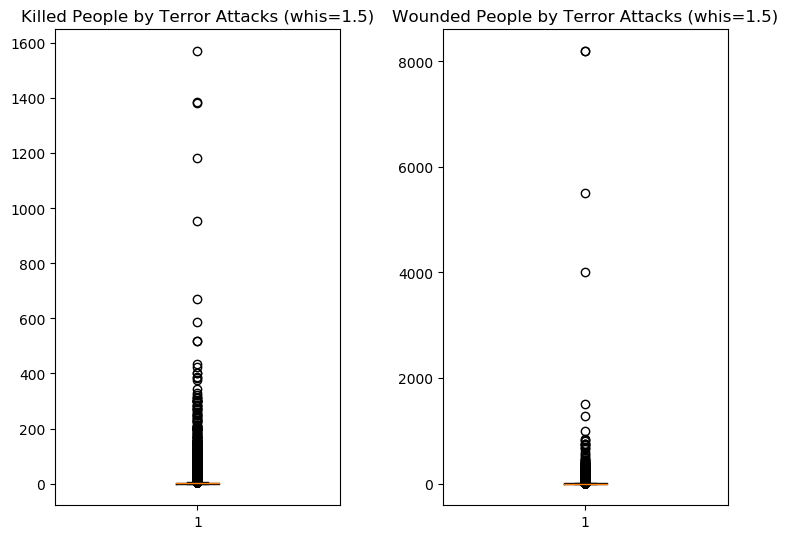

In [15]:
for i,j in enumerate(['Killed','Wounded']):
    plt.subplot(1,2,i+1)
    plt.boxplot(w_df[j] )
    plt.title("{} People by Terror Attacks (whis=1.5)".format(j))
    
plt.tight_layout()
plt.show()

## Z-score

In [16]:
from scipy.stats import zscore

z_scores = zscore(w_df["Killed"])
for threshold in range(1,6):
    print("Eşik değeri: {}".format(threshold))
    print("Aykırı değerlerin sayısı: {}".format(len((np.where(z_scores > threshold)[0]))))
    print('------')

Eşik değeri: 1
Aykırı değerlerin sayısı: 5831
------
Eşik değeri: 2
Aykırı değerlerin sayısı: 2525
------
Eşik değeri: 3
Aykırı değerlerin sayısı: 1346
------
Eşik değeri: 4
Aykırı değerlerin sayısı: 848
------
Eşik değeri: 5
Aykırı değerlerin sayısı: 581
------


Outlier values decrease as the threshold of z-scores increases

In [17]:
from scipy.stats.mstats import winsorize

winsorize_killed = winsorize(w_df["Killed"], (0, 0.10))

winsorize_killed

masked_array(data=[1., 0., 1., ..., 0., 0., 0.],
             mask=False,
       fill_value=1e+20)

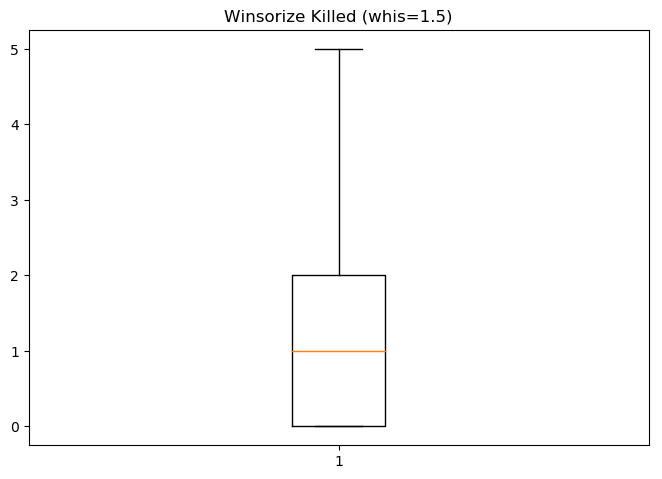

In [18]:
plt.boxplot(winsorize_killed)
plt.title("Winsorize Killed (whis=1.5)")
plt.show()

WİNSORİZE YAP!!!

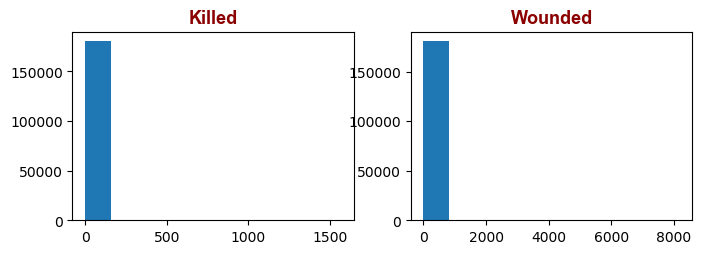

In [19]:
degisken=['Killed','Wounded']

for i in range(2):
    plt.subplot(2, 2, i+1)
    plt.hist(w_df[degisken[i]])
    plt.title(degisken[i], fontdict=baslik_font)
    

In [20]:
np.sum(w_df['Killed'])

436106.1827323567

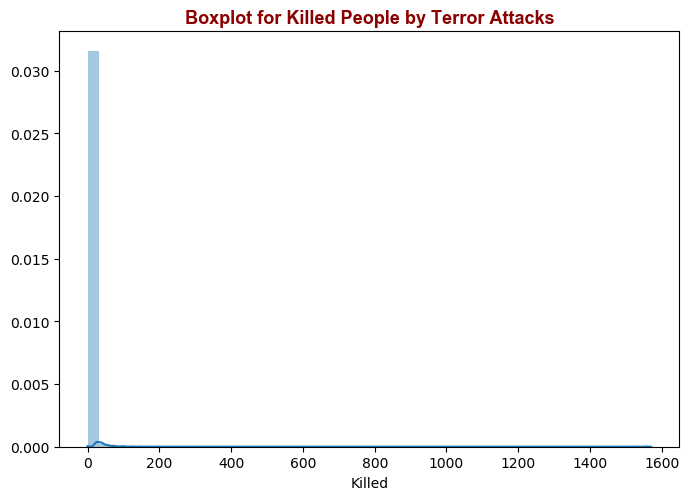

In [21]:
sns.distplot(w_df["Killed"])
plt.title("Boxplot for Killed People by Terror Attacks", fontdict=baslik_font)
plt.show()

## 5. Data Exploration

In [22]:
w_df.groupby('Region')['Killed'].sum()

Region
Australasia & Oceania             164.436061
Central America & Caribbean     34294.755581
Central Asia                     1009.624041
East Asia                        1245.834396
Eastern Europe                   7814.397686
Middle East & North Africa     143055.861083
North America                    5139.758944
South America                   32871.848980
South Asia                     103315.431516
Southeast Asia                  16039.058803
Sub-Saharan Africa              82266.894381
Western Europe                   8888.281262
Name: Killed, dtype: float64

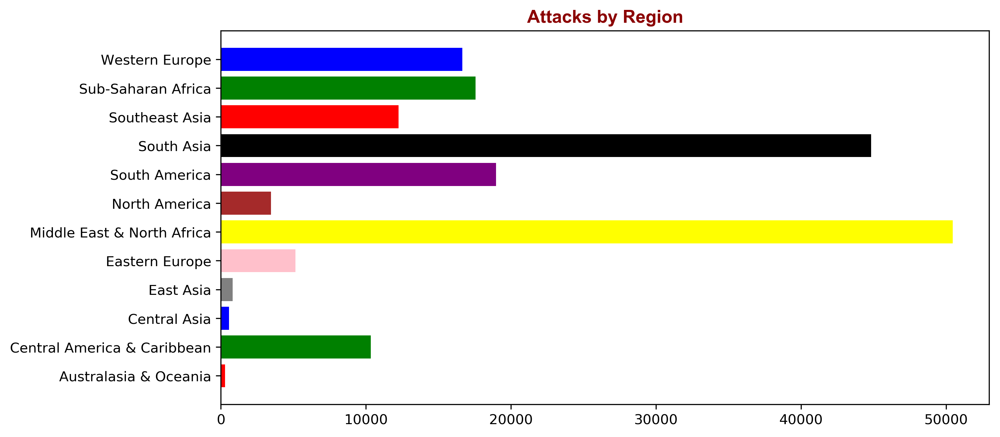

In [23]:
plt.figure(figsize=(10,5), dpi=300)
plt.barh(w_df.groupby("Region")["Region"].count().index, 
        w_df.groupby("Region")["Region"].count(), 
        color=["red","green","blue","grey","pink","yellow","brown","purple","black"])
plt.title("Attacks by Region", fontdict=baslik_font)

plt.show()

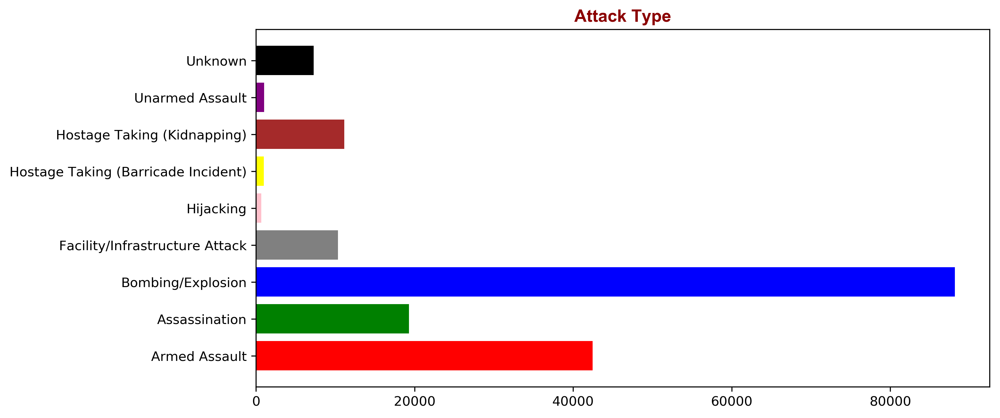

In [24]:
plt.figure(figsize=(10,5), dpi=300)
plt.barh(w_df.groupby("Attack_Type")["Attack_Type"].count().index, 
        w_df.groupby("Attack_Type")["Attack_Type"].count(), 
        color=["red","green","blue","grey","pink","yellow","brown","purple","black"])
plt.title("Attack Type", fontdict=baslik_font)

plt.show()

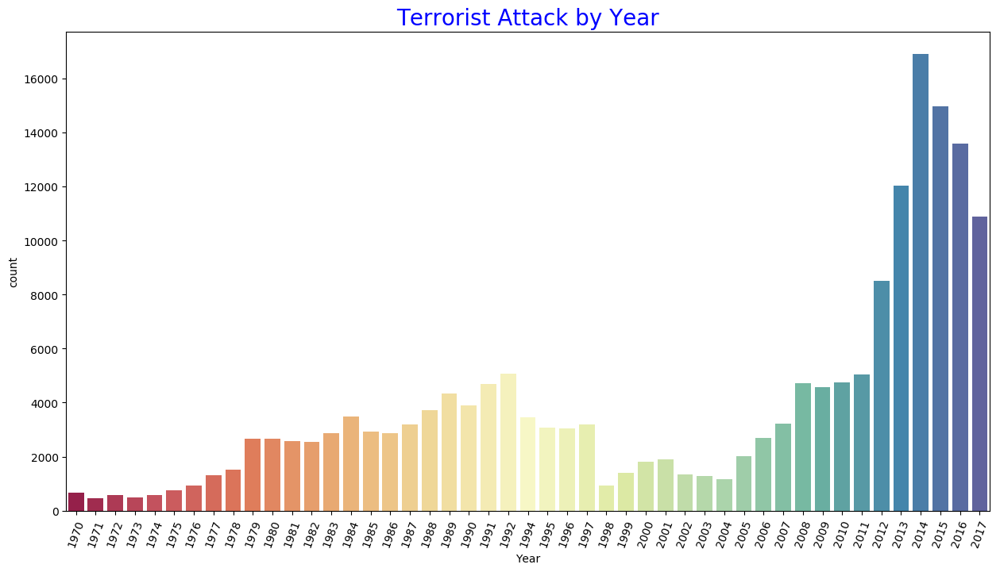

In [25]:
plt.subplots(figsize=(15,8))
sns.countplot('Year',data=w_df,palette='Spectral')
plt.xticks(rotation=70)
plt.title('Terrorist Attack by Year', color='blue',size='20')
plt.show()

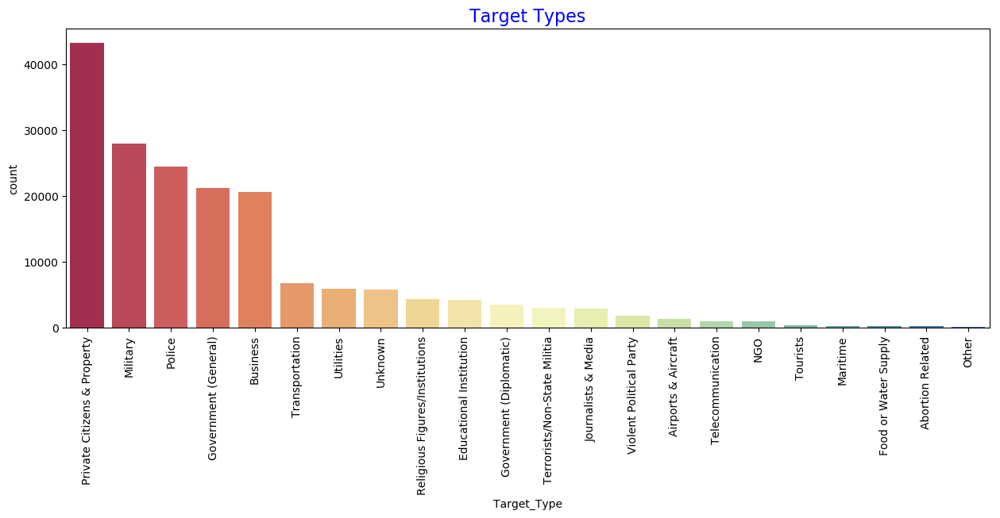

In [26]:
plt.figure(figsize=(15,5))
sns.countplot(w_df['Target_Type'],palette='Spectral',
              order=w_df['Target_Type'].value_counts().index)
plt.xticks(rotation=90)
plt.title('Target Types', fontsize=16, color='Blue')
plt.show()

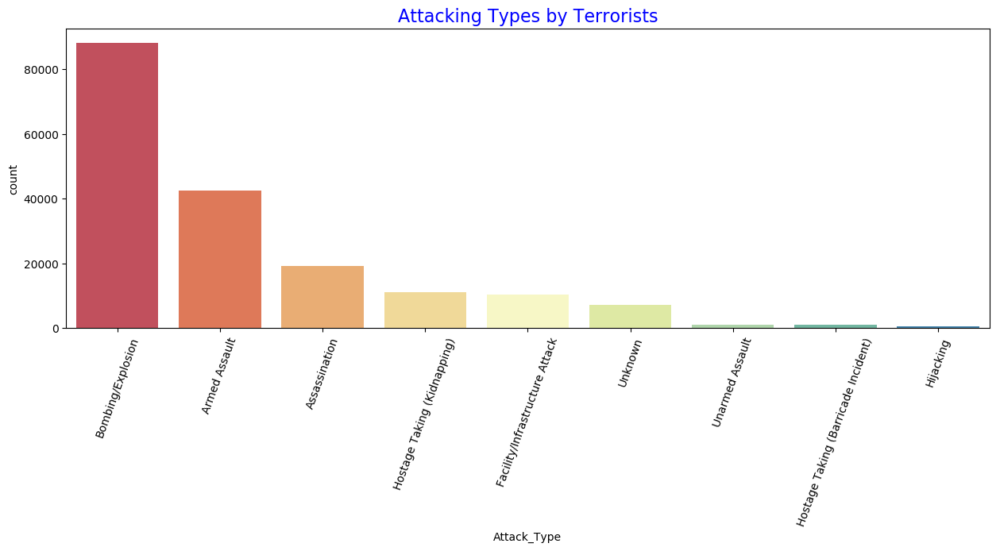

In [27]:
plt.subplots(figsize=(15,5))
sns.countplot('Attack_Type', data=w_df,palette='Spectral',
              order=w_df['Attack_Type'].value_counts().index)
plt.xticks(rotation=70)
plt.title('Attacking Types by Terrorists', fontsize=16, color='blue')
plt.show()

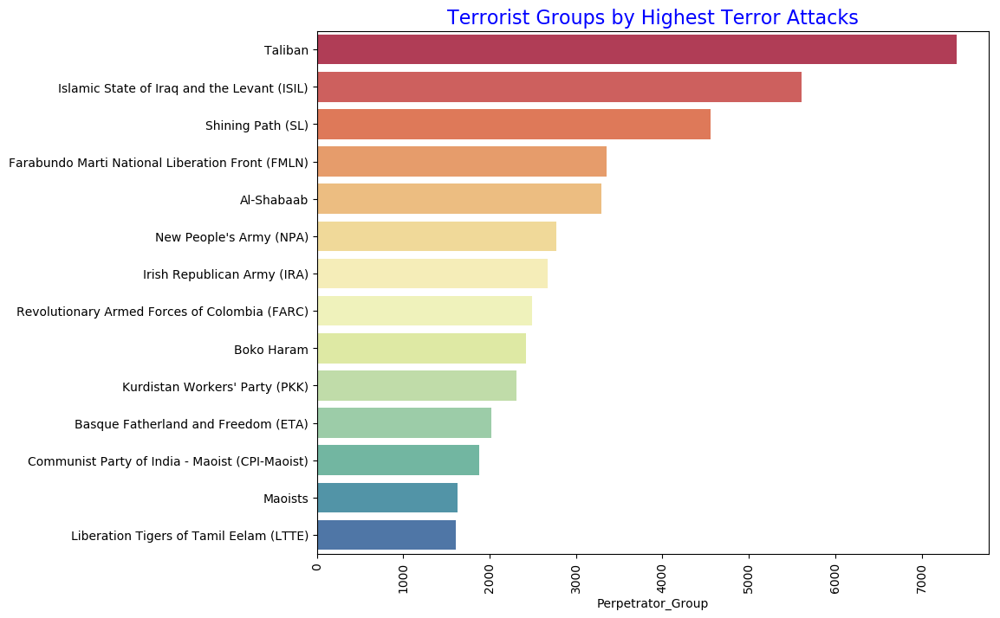

In [28]:
sns.barplot(w_df['Perpetrator_Group'].value_counts()[1:15], 
            w_df['Perpetrator_Group'].value_counts()[1:15].index,palette=('Spectral'))
plt.xticks(rotation=90)
fig=plt.gcf()
fig.set_size_inches(10,8)
plt.title('Terrorist Groups by Highest Terror Attacks', fontsize=16, color='blue')
plt.show()

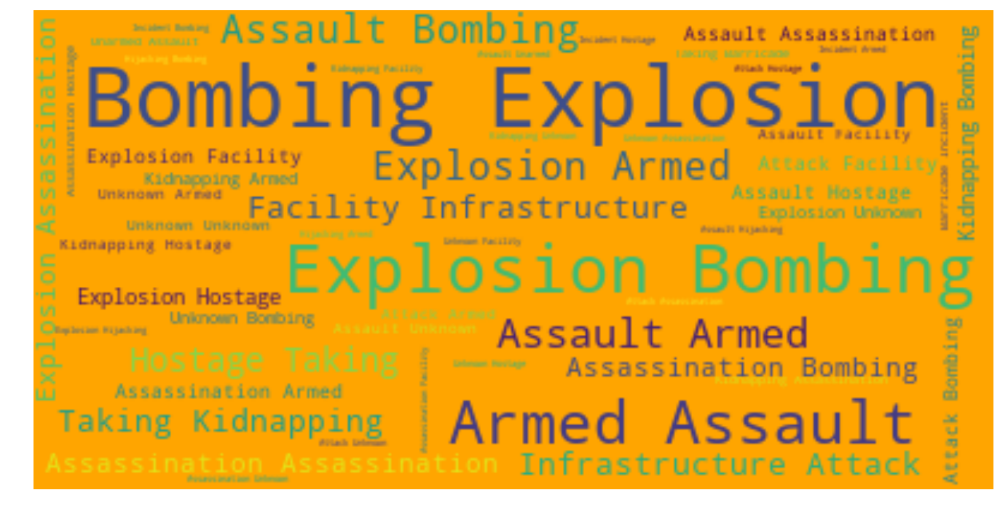

In [29]:
from wordcloud import WordCloud

# word cloud imajı oluşturuyoruz.
wordcloud = WordCloud(background_color="orange").generate(" ".join(w_df["Attack_Type"]))
plt.figure(figsize=(17,10))
# Oluşturulan imajı gösteriyoruz.
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")

plt.show()

In [30]:
w_df.corr()

,Year,Month,Day,Country_Code,Latitude,Longitude,Attack_Code,Target_Code,Weapon_Code,Killed,Wounded
Year,1.000000,0.000109,0.018252,-0.135065,0.167330,0.003915,0.074417,0.079031,-0.011674,0.014643,0.014099
Month,0.000109,1.000000,0.005561,-0.006445,-0.015802,-0.003885,0.006900,-0.000968,0.008152,0.003367,0.002788
Day,0.018252,0.005561,1.000000,0.003343,0.003568,-0.002287,-0.005051,-0.000165,-0.002637,-0.003588,-0.001245
Country_Code,-0.135065,-0.006445,0.003343,1.000000,0.180121,-0.000269,-0.020942,-0.020045,-0.023118,-0.014514,-0.003108
Latitude,0.167330,-0.015802,0.003568,0.180121,1.000000,0.001466,0.009508,-0.022642,-0.012433,-0.017632,0.015009
Longitude,0.003915,-0.003885,-0.002287,-0.000269,0.001466,1.000000,0.001556,-0.003422,0.001585,-0.000561,0.000223
Attack_Code,0.074417,0.006900,-0.005051,-0.020942,0.009508,0.001556,1.000000,0.014602,0.658611,0.002332,0.000786
Target_Code,0.079031,-0.000968,-0.000165,-0.020045,-0.022642,-0.003422,0.014602,1.000000,0.020030,0.008277,0.010867
Weapon_Code,-0.011674,0.008152,-0.002637,-0.023118,-0.012433,0.001585,0.658611,0.020030,1.000000,0.003758,-0.008952
Killed,0.014643,0.003367,-0.003588,-0.014514,-0.017632,-0.000561,0.002332,0.008277,0.003758,1.000000,0.445117


bitane t-test yapalım(bölgelere kıyaslama anlamlımı)
hitmap grafikten sonra bak


In [31]:
import plotly.express as px

fig = px.choropleth(w_df, 
                    locations="Country_Name", 
                    locationmode = "country names", 
                    color='Killed',
                    range_color=(0,100),
                    hover_name='Country_Name', 
                    animation_frame="Year"
                   )

fig.update_layout(
    title_text = 'Terrorist Attack On The World',
    title_x = 0.5,
    geo=dict(
        showframe = False,
        showcoastlines = False,
    ))
fig

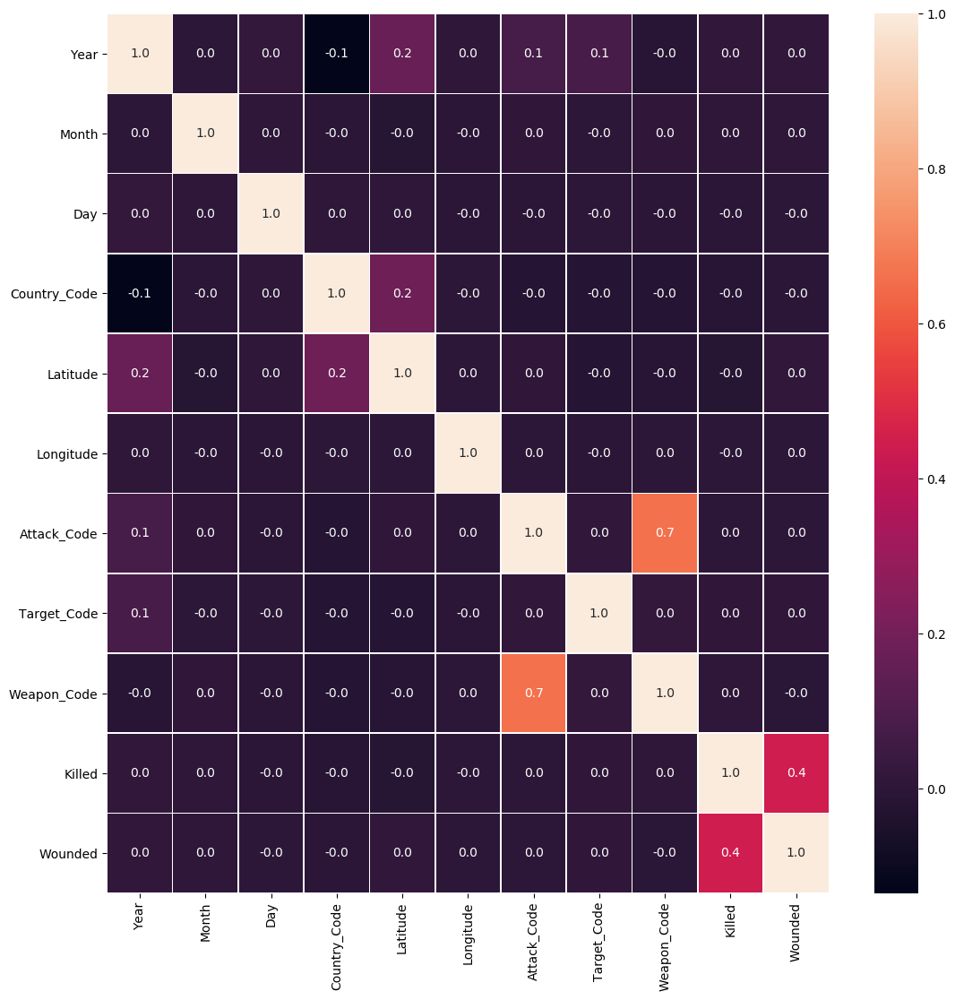

In [32]:
f,ax = plt.subplots(figsize=(13, 13))
sns.heatmap(w_df.corr(), annot=True, linewidths=.5, fmt= '.1f',ax=ax)
plt.show()

In [39]:
w_df.groupby('Region').count().Killed

Region
Australasia & Oceania            282
Central America & Caribbean    10344
Central Asia                     562
East Asia                        802
Eastern Europe                  5139
Middle East & North Africa     50444
North America                   3456
South America                  18978
South Asia                     44824
Southeast Asia                 12237
Sub-Saharan Africa             17550
Western Europe                 16639
Name: Killed, dtype: int64

In [45]:
import scipy.stats as stats
Region = w_df["Region"].unique()
group_w_df = w_df.groupby("Region")

In [48]:
pd.options.display.float_format = '{:.15f}'.format
for var in ["Killed"]:
    Comparison = pd.DataFrame(columns=['Group_1', 'Group_2', 'Statistics','p_value'])
    print("Comparison for {}".format(var),end='')
    for i in range(0, len(Region)):
        for j in range(i+1, len(Region)):
            ttest = stats.ttest_ind(w_df[w_df["Region"]==Region[i]][var], 
                                w_df[w_df["Region"]==Region[j]][var])
            Group_1 = Region[i]
            Group_2 = Region[j]
            Statistics = ttest[0]
            p_value = ttest[1]
            
            Comparison = Comparison.append({"Group_1" : Group_1 ,
                                                  "Group_2" : Group_2 ,
                                                "Statistics" : Statistics,
                                                  "p_value" : p_value}, ignore_index=True)
    display(Comparison)

Comparison for Killed

,Group_1,Group_2,Statistics,p_value
0,Central America & Caribbean,North America,4.839342817241337,0.000001316785131
1,Central America & Caribbean,Southeast Asia,19.942901285190995,0.000000000000000
2,Central America & Caribbean,Western Europe,32.775233551697333,0.000000000000000
3,Central America & Caribbean,East Asia,4.753622777633377,0.000002023039398
4,Central America & Caribbean,South America,17.519636801637866,0.000000000000000
5,Central America & Caribbean,Eastern Europe,10.551008033641489,0.000000000000000
6,Central America & Caribbean,Sub-Saharan Africa,-7.206603998915681,0.000000000000588
7,Central America & Caribbean,Middle East & North Africa,3.546252736521148,0.000391044947271
8,Central America & Caribbean,Australasia & Oceania,4.472611591677783,0.000007807229146
9,Central America & Caribbean,South Asia,11.962542323869378,0.000000000000000


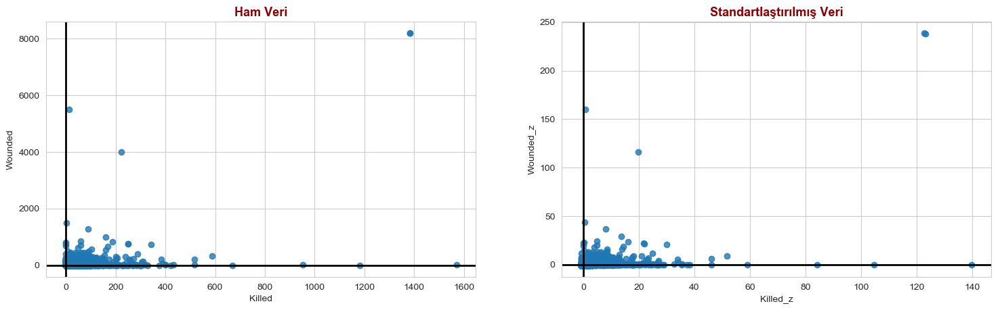

In [54]:
plt.figure(figsize=(18,5))
plt.subplot(1,2,1)

t = sns.regplot('Killed', 'Wounded', w_df, x_jitter=.49, y_jitter=.49, fit_reg=False)
t.axhline(0, color='k', linestyle='-', linewidth=2)
t.axvline(0, color='k', linestyle='-', linewidth=2)
t.axes.set_title('Ham Veri', fontdict = baslik_font)

plt.subplot(1,2,2)

w_st_df = pd.DataFrame()
w_st_df['Killed_z'] = (w_df['Killed'] - w_df['Killed'].mean()) / w_df['Killed'].std()
w_st_df['Wounded_z'] = (w_df['Wounded'] - w_df['Wounded'].mean()) / w_df['Wounded'].std()

t = sns.regplot('Killed_z','Wounded_z',w_st_df, x_jitter=.49, y_jitter=.49, fit_reg=False )
t.axhline(0, color='k', linestyle='-', linewidth=2)
t.axvline(0, color='k', linestyle='-', linewidth=2)
t.axes.set_title('Standartlaştırılmış Veri', fontdict = baslik_font)
plt.show()

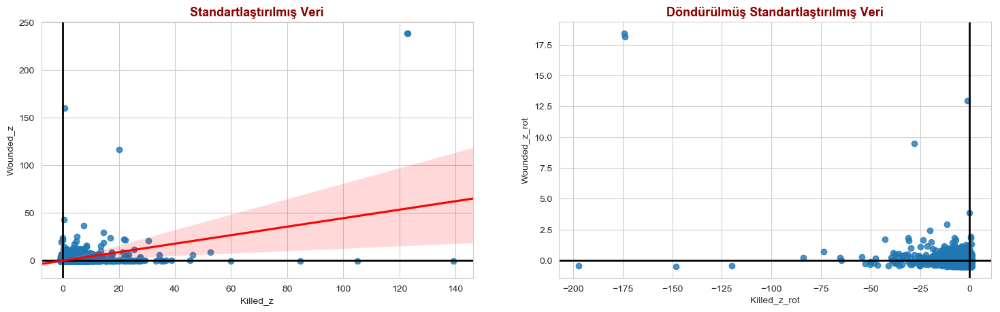

In [55]:
plt.figure(figsize=(18,5))
plt.subplot(1,2,1)

t = sns.regplot('Killed_z', 'Wounded_z', w_st_df, x_jitter=.49, y_jitter=.49, fit_reg=False)
t.axhline(0, color='k', linestyle='-', linewidth=2)
t.axvline(0, color='k', linestyle='-', linewidth=2)
t.axes.set_title('Standartlaştırılmış Veri', fontdict = baslik_font)

sns.regplot('Killed_z', 'Wounded_z', w_st_df, scatter=False, color="red")

plt.subplot(1,2,2)

w_st_df['Killed_z_rot'] = math.cos(40) * w_st_df['Killed_z'] - math.sin(40) * w_st_df['Killed_z']
w_st_df['Wounded_z_rot'] = math.sin(40) * w_st_df['Wounded_z'] + math.cos(40) * w_st_df['Wounded_z']

t = sns.regplot('Killed_z_rot','Wounded_z_rot', w_st_df, x_jitter=.49, y_jitter=.49,fit_reg=False )
t.axhline(0, color='k', linestyle='-', linewidth=2)
t.axvline(0, color='k', linestyle='-', linewidth=2)
t.axes.set_title('Döndürülmüş Standartlaştırılmış Veri', fontdict = baslik_font)
plt.show()

In [58]:
X = StandardScaler().fit_transform(w_df)
sklearn_pca = PCA(n_components=5)
Y_sklearn = sklearn_pca.fit_transform(X)

P = eig_vec_cov[:, 0]

Y = P.T.dot(Xt)

print(
    'Veri kümesindeki toplam varyans yüzdesi',
    'Elle hesaplanan bileşen.\n',
    sklearn_pca.explained_variance_ratio_
)

# Compare the sklearn solution to ours – a perfect match.
plt.plot(Y_sklearn[:, 0], Y, 'o')
plt.title('Çözümlerin Karşılaştırılması')
plt.ylabel('Sklearn Bileşeni 1')
plt.xlabel('Elle Hesaplanan Bileşen 1')
plt.show()

ValueError: could not convert string to float: 'Dominican Republic'

In [ ]:
from mpl_toolkits.basemap import Basemap
top_groups=w_df[w_df['Perpetrator_Group'].isin(w_df['Perpetrator_Group'].value_counts()[:14].index)]
m4 = Basemap(projection='mill',llcrnrlat=-80,urcrnrlat=80, llcrnrlon=-180,urcrnrlon=180,lat_ts=20,resolution='c',lat_0=True,lat_1=True)
m4.drawcoastlines()
m4.drawcountries()
m4.fillcontinents(lake_color='aqua')
m4.drawmapboundary(fill_color='aqua')
fig=plt.gcf()
fig.set_size_inches(22,10)
colors=['r','g','b','y','#800000','#ff1100','#8202fa','#20fad9','#ff5733','#fa02c6',"#f99504",'#b3b6b7','#8e44ad','#1a2b3c']
group=list(top_groups['Perpetrator_Group'].unique())
def group_point(group,color,label):
    lat_group=list(top_groups[top_groups['Perpetrator_Group']==group].latitude)
    long_group=list(top_groups[top_groups['Perpetrator_Group']==group].longitude)
    x_group,y_group=m4(long_group,lat_group)
    m4.plot(x_group,y_group,'go',markersize=3,color=j,label=i)
for i,j in zip(group,colors):
    group_point(i,j,i)
legend=plt.legend(loc='lower left',frameon=True,prop={'size':10})
frame=legend.get_frame()
frame.set_facecolor('white')
plt.title('Regional Activities of Terrorist Groups')
plt.show()

In [51]:
import math
from sklearn.decomposition import PCA

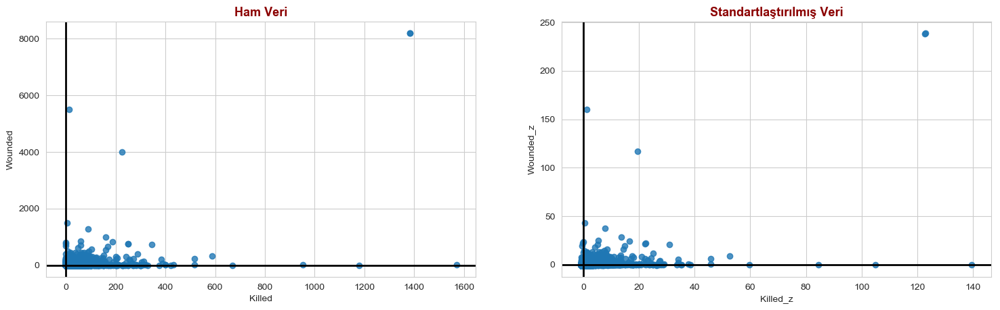

In [53]:
plt.figure(figsize=(18,5))
plt.subplot(1,2,1)

t = sns.regplot('Killed', 'Wounded', w_df, x_jitter=.49, y_jitter=.49, fit_reg=False)
t.axhline(0, color='k', linestyle='-', linewidth=2)
t.axvline(0, color='k', linestyle='-', linewidth=2)
t.axes.set_title('Ham Veri', fontdict = baslik_font)

plt.subplot(1,2,2)

w_st_df = pd.DataFrame()
w_st_df['Killed_z'] = (w_df['Killed'] - w_df['Killed'].mean()) / w_df['Killed'].std()
w_st_df['Wounded_z'] = (w_df['Wounded'] - w_df['Wounded'].mean()) / w_df['Wounded'].std()

t = sns.regplot('Killed_z','Wounded_z',w_st_df, x_jitter=.49, y_jitter=.49, fit_reg=False )
t.axhline(0, color='k', linestyle='-', linewidth=2)
t.axvline(0, color='k', linestyle='-', linewidth=2)
t.axes.set_title('Standartlaştırılmış Veri', fontdict = baslik_font)
plt.show()

In [ ]:
plt.figure(figsize=(18,5))
plt.subplot(1,2,1)

t = sns.regplot('Killed_z', 'Wounded_z', w_st_df, x_jitter=.49, y_jitter=.49, fit_reg=False)
t.axhline(0, color='k', linestyle='-', linewidth=2)
t.axvline(0, color='k', linestyle='-', linewidth=2)
t.axes.set_title('Standartlaştırılmış Veri', fontdict = baslik_font)

sns.regplot('Crossing_z', 'Finishing_z', fifa_st_df, scatter=False, color="red")

plt.subplot(1,2,2)

fifa_st_df['Crossing_z_rot'] = math.cos(40) * fifa_st_df['Crossing_z'] - math.sin(40) * fifa_st_df['Crossing_z']
fifa_st_df['Finishing_z_rot'] = math.sin(40) * fifa_st_df['Finishing_z'] + math.cos(40) * fifa_st_df['Finishing_z']

t = sns.regplot('Crossing_z_rot','Finishing_z_rot', fifa_st_df, x_jitter=.49, y_jitter=.49,fit_reg=False )
t.axhline(0, color='k', linestyle='-', linewidth=2)
t.axvline(0, color='k', linestyle='-', linewidth=2)
t.axes.set_title('Döndürülmüş Standartlaştırılmış Veri', fontdict = baslik_font)
plt.show()

In [52]:
x= w_df2.drop(columns=['Killed'],inplace=True, axis=1)
pca=PCA(n_components=3)
w_df_pca = pca.fit_transform(x)
components= np.round(pca.explained_variance_ratio_*100,decimals=2) 
labels = ['PC1','PC2','PC3']
plt.bar(x=range(1,len(components)+1), height=components, tick_label=labels)
plt.ylabel('Percentage of Explained Variance')
plt.xlabel('Principal Component')
print (components)
plt.show()

KeyError: "['Killed'] not found in axis"